In [1]:
import pandas as pd

file_1_df = pd.read_csv('resources/file_1.csv')
file_2_df = pd.read_csv('resources/file_2.csv')
file_2_clean_df = file_2_df.dropna(subset=["Latitude", "Longitude"]).copy()

Join 2 DataFrames


In [2]:
file_1_subset = file_1_df[
    ["Borehole ID",
     "Elevation (borehole_info: D)",
     "Depth to Water (hydrologic: B)"]
]
file_1_subset = file_1_subset.rename(columns={"Elevation (borehole_info: D)": "Elevation"})


# Perform the merge
merged_df = file_2_clean_df.merge(file_1_subset, on="Borehole ID", how="left")
merged_df['Lithology_layer_depth'] = merged_df['Bottom Depth'] - merged_df['Top Depth']


In [3]:
merged_df.to_csv('resources/borehole_logs.csv', index=False)

In [4]:
print(merged_df['Lithology'].unique())
# Full list of lithologies grouped and ordered
grouped_lithologies = {
    'Organic Soils': ['Topsoil / vegetation', 'Peat'],
    'Silts': ['Silt', 'Sandy silt', 'Clayey silt', 'Gravelly silt'],
    'Clays': ['Clay', 'Silty clay', 'Sandy clay', 'Clayey sand', 'Clayey gravel', 'Gravelly clay'],
    'Sands': ['Sand', 'Silty sand', 'Gravelly sand', 'Sandy gravel'],
    'Gravels': ['Gravel', 'Silty gravel'],
    'Mixed / Non-standard': ['Fill', 'Debris', 'Asphalt / concrete', 'Cobbles / boulders', 'Volcanic ash'],
    'Bedrock / Rock': ['Sedimentary bedrock', 'Undifferentiated rock', 'Plutonic bedrock', 'Volcanic bedrock', 'Metamorphic bedrock'],
    'Data not available': ['Undefined', 'N/A']
}

group_to_rank = {
    'Organic Soils': 1,
    'Silts': 2,
    'Clays': 3,
    'Sands': 4,
    'Gravels': 5,
    'Mixed / Non-standard': 6,
    'Bedrock / Rock': 7,
    'Data not available': 8
}

# Create lithology-to-group and lithology-to-index mappings
lithology_to_group = {}
lithology_to_index = {}

for group, lithologies in grouped_lithologies.items():
    rank = group_to_rank[group]
    for i, lith in enumerate(lithologies):
        lithology_to_group[lith] = group
        lithology_to_index[lith] = rank * 100 + i

# Function to convert DataFrame columns
def convert_lithology(df, lithology_column='Lithology'):
    df['Lithology_Group'] = df[lithology_column].map(lithology_to_group)
    df['Lithology_Rank'] = df['Lithology_Group'].map(group_to_rank)
    df['Lithology_Index'] = df[lithology_column].map(lithology_to_index)
    return df

['Fill' 'Sandy silt' 'Silt' 'Topsoil / vegetation' 'Silty sand' 'Clay'
 'Silty clay' 'Clayey silt' 'Clayey sand' 'Sand' 'Undefined' 'Gravel'
 'Gravelly sand' 'Asphalt / concrete' 'Peat' 'Sandy gravel' 'Debris'
 'Sandy clay' 'Silty gravel' 'Sedimentary bedrock' 'Gravelly silt'
 'Gravelly clay' 'Undifferentiated rock' 'Clayey gravel'
 'Cobbles / boulders' 'Plutonic bedrock' 'Volcanic ash' 'Volcanic bedrock'
 'Metamorphic bedrock']


In [5]:
df = pd.read_csv('resources/borehole_logs.csv')
converted_df= convert_lithology(df)
converted_df.to_csv('resources/lithology_group.csv', index=False)


/var/folders/v8/z62syxvx173303z_ts3j44n40000gn/T/ipykernel_10145/3871906372.py:1: DtypeWarning: Columns (11) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv('resources/borehole_logs.csv')


merge consecutive layers
📝 Example
Before:
Borehole ID	Sub Borehole Layer	Lithology	Top Depth	Bottom Depth
1	        4	                Silt	    3.0	        4.0
1	        5	                Silt	    4.0	        5.0

After:
Borehole ID	Sub Borehole Layer	Lithology	Top Depth	Bottom Depth
1	            4	            Silt	    3.0	        5.0

In [6]:
import pandas as pd

# Load data
df = pd.read_csv('resources/lithology_group.csv')
df.columns = df.columns.str.strip()

# Sort for proper processing
df = df.sort_values(by=['Borehole ID', 'Sub Borehole Layer']).reset_index(drop=True)

# Result list
merged_rows = []

# Group by Borehole ID
for borehole_id, group in df.groupby('Borehole ID'):
    group = group.sort_values(by='Sub Borehole Layer').reset_index(drop=True)
    i = 0
    while i < len(group):
        current_row = group.iloc[i].copy()
        j = i + 1
        # Start checking consecutive rows
        while (
            j < len(group)
            and group.loc[j, 'Lithology'] == current_row['Lithology']
            and group.loc[j, 'Sub Borehole Layer'] == current_row['Sub Borehole Layer'] + (j - i)
        ):
            current_row['Bottom Depth'] = group.loc[j, 'Bottom Depth']
            j += 1
        # Set new Sub Borehole Layer (optional: store the range or lowest one)
        current_row['Sub Borehole Layer'] = group.loc[i, 'Sub Borehole Layer']
        merged_rows.append(current_row)
        i = j

# Final merged DataFrame
merged_df = pd.DataFrame(merged_rows)

# Save if needed
merged_df.to_csv("resources/merged_borehole_layers_lithology_group.csv", index=False)


/var/folders/v8/z62syxvx173303z_ts3j44n40000gn/T/ipykernel_10145/3601201422.py:4: DtypeWarning: Columns (11) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv('resources/lithology_group.csv')


In [ ]:
import pandas as pd
import plotly.express as px

# Load and clean data
clean_df = pd.read_csv('resources/merged_borehole_layers_lithology_group.csv')
unique_df = clean_df.drop_duplicates(subset=["Borehole ID"]).copy()

# Get count of unique Borehole IDs
borehole_count = unique_df["Borehole ID"].nunique()

# Plot using Lith_1 as color
fig = px.scatter_mapbox(
    unique_df,
    lat="Latitude",
    lon="Longitude",
    color="Lith_1",  # Use soil type as color
    zoom=10,
    height=600,
    title=f"Lith_1 Distribution (Count = {borehole_count})"
)

fig.update_layout(mapbox_style="open-street-map")
fig.show()

In [8]:
import pandas as pd

# Load and clean
df = pd.read_csv('resources/merged_borehole_layers_lithology_group.csv')
df.columns = df.columns.str.strip()

# Group and count layers per borehole
layer_counts = df.groupby('Borehole ID').size().reset_index(name='Layer Count')

# Get top 5 boreholes with the most layers
top_boreholes = layer_counts.sort_values(by='Layer Count', ascending=False).head()
max_layers = layer_counts['Layer Count'].max()
print(f"Max number of layers in a single borehole: {max_layers}")
print(top_boreholes.head())

# Filter original DataFrame
filtered_df = df[df['Borehole ID'].isin(top_boreholes['Borehole ID'])]

# Save to CSV
filtered_df.to_csv("resources/top_borehole_records.csv", index=False)
print("Saved full records of top boreholes to 'top_borehole_records.csv'")

# Distribution bins
bins = [0, 5, 10, 20, 50, 100]
labels = ['1-5', '6-10', '11-20', '21-50', '51-100']
layer_counts['Layer Range'] = pd.cut(layer_counts['Layer Count'], bins=bins, labels=labels, right=True)

# Count and percentage per group
distribution = layer_counts['Layer Range'].value_counts().sort_index().reset_index()
distribution.columns = ['Layer Range', 'Count']
distribution['Percentage'] = (distribution['Count'] / distribution['Count'].sum() * 100).round(2)

print("\nLayer Count Distribution:")
print(distribution)

Max number of layers in a single borehole: 76
       Borehole ID  Layer Count
63159        70329           76
63158        70328           67
63875        71903           65
61591        68502           65
63876        71904           63
Saved full records of top boreholes to 'top_borehole_records.csv'

Layer Count Distribution:
  Layer Range  Count  Percentage
0         1-5  79334       90.87
1        6-10   6844        7.84
2       11-20   1008        1.15
3       21-50    113        0.13
4      51-100      5        0.01


/var/folders/v8/z62syxvx173303z_ts3j44n40000gn/T/ipykernel_10145/4041178284.py:4: DtypeWarning: Columns (11) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv('resources/merged_borehole_layers_lithology_group.csv')


✅ Code to Keep Only Boreholes with 1–10 Layers:

In [10]:
import pandas as pd

# Load and clean
df = pd.read_csv('resources/merged_borehole_layers_lithology_group.csv')
df.columns = df.columns.str.strip()

# Group and count layers per borehole
layer_counts = df.groupby('Borehole ID').size().reset_index(name='Layer Count')

# Filter to only 1-10 layers
valid_ids = layer_counts[layer_counts['Layer Count'].between(1, 10)]['Borehole ID']

# Filter the original DataFrame
filtered_df = df[df['Borehole ID'].isin(valid_ids)]

# Save or preview
filtered_df.to_csv("resources/boreholes_1_to_10_layers_lithology_group.csv", index=False)
print(f"Filtered boreholes with 1–10 layers: {filtered_df['Borehole ID'].nunique()} boreholes saved.")


/var/folders/v8/z62syxvx173303z_ts3j44n40000gn/T/ipykernel_10145/3737852120.py:4: DtypeWarning: Columns (11) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv('resources/merged_borehole_layers_lithology_group.csv')


Filtered boreholes with 1–10 layers: 86178 boreholes saved.


✅ Final Structure (Per Layer)

🔢 Inputs (Features):
- Latitude
- Longitude
- Elevation

🎯 Outputs:
- Lithology → classification
- Top Depth → regression
- Bottom Depth → regression



In [34]:
import pandas as pd

df = pd.read_csv("resources/boreholes_1_to_10_layers_lithology_group.csv", low_memory=False)
df.columns = df.columns.str.strip()  # Clean whitespace

print(df.columns.tolist())  # Print all column names

def reshape_borehole(group, max_layers=10):
    row = {
        'Borehole ID': group['Borehole ID'].iloc[0],
        'Latitude': group['Latitude'].iloc[0],
        'Longitude': group['Longitude'].iloc[0],
        'Elevation': group['Elevation'].iloc[0],
    }
    group = group.sort_values(by='Top Depth')
    for i in range(max_layers):
        if i < len(group):
            row[f'Lith_{i+1}'] = group['Lithology'].iloc[i],
            row[f'Lithology_Index_{i+1}'] = group['Lithology_Index'].iloc[i]
            row[f'Lithology_Rank_{i+1}'] = group['Lithology_Rank'].iloc[i]
            row[f'Lithology_layer_depth_{i+1}'] = group['Lithology_layer_depth'].iloc[i]
        else:
            row[f'Lith_{i+1}'] = 'N/A'
            row[f'Lithology_Index_{i+1}'] = 900
            row[f'Lithology_Rank_{i+1}'] = 0.0
            row[f'Lithology_layer_depth_{i+1}'] = 0.0
    return pd.Series(row)

# Apply to full dataframe
reshaped_df = df.groupby('Borehole ID').apply(reshape_borehole).reset_index(drop=True)

# Save for reuse
reshaped_df.to_csv("resources/boreholes_reshaped_layers_lithology_group.csv", index=False)
print("✅ Reshaped to wide format with up to 10 layers per borehole.")

['Borehole ID', 'Document ID', 'Sub Borehole Layer', 'Latitude', 'Longitude', 'Top Depth', 'Bottom Depth', 'Description', 'USCS', 'Lithology', 'Elevation', 'Depth to Water (hydrologic: B)', 'Lithology_layer_depth', 'Lithology_Group', 'Lithology_Rank', 'Lithology_Index']


/var/folders/v8/z62syxvx173303z_ts3j44n40000gn/T/ipykernel_10145/2322166513.py:30: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  reshaped_df = df.groupby('Borehole ID').apply(reshape_borehole).reset_index(drop=True)


✅ Reshaped to wide format with up to 10 layers per borehole.


Plot Lith_1 distribution

In [35]:
import pandas as pd
import plotly.express as px

# Load and clean data
clean_df = pd.read_csv('resources/boreholes_reshaped_layers_lithology_group.csv')
unique_df = clean_df.drop_duplicates(subset=["Borehole ID"]).copy()
print("Columns:", unique_df.columns.tolist())

# Print count and percentage of each Lith_1 value
lith_counts = unique_df["Lith_1"].value_counts(dropna=False)
lith_percentages = lith_counts / len(unique_df) * 100
lith_summary = pd.DataFrame({
    "Lith_1": lith_counts.index,
    "Count": lith_counts.values,
    "Percentage": lith_percentages.round(2)
})

print("\nLith_1 Value Distribution:")
print(lith_summary.to_string(index=False))


Columns: ['Borehole ID', 'Latitude', 'Longitude', 'Elevation', 'Lith_1', 'Lithology_Index_1', 'Lithology_Rank_1', 'Lithology_layer_depth_1', 'Lith_2', 'Lithology_Index_2', 'Lithology_Rank_2', 'Lithology_layer_depth_2', 'Lith_3', 'Lithology_Index_3', 'Lithology_Rank_3', 'Lithology_layer_depth_3', 'Lith_4', 'Lithology_Index_4', 'Lithology_Rank_4', 'Lithology_layer_depth_4', 'Lith_5', 'Lithology_Index_5', 'Lithology_Rank_5', 'Lithology_layer_depth_5', 'Lith_6', 'Lithology_Index_6', 'Lithology_Rank_6', 'Lithology_layer_depth_6', 'Lith_7', 'Lithology_Index_7', 'Lithology_Rank_7', 'Lithology_layer_depth_7', 'Lith_8', 'Lithology_Index_8', 'Lithology_Rank_8', 'Lithology_layer_depth_8', 'Lith_9', 'Lithology_Index_9', 'Lithology_Rank_9', 'Lithology_layer_depth_9', 'Lith_10', 'Lithology_Index_10', 'Lithology_Rank_10', 'Lithology_layer_depth_10']

Lith_1 Value Distribution:
                    Lith_1  Count  Percentage
           ('Silty sand',)  26104       30.29
 ('Topsoil / vegetation',)  20342

In [37]:
import pandas as pd
import plotly.express as px

# Load and clean data
clean_df = pd.read_csv('resources/boreholes_reshaped_layers_lithology_group.csv')
unique_df = clean_df.drop_duplicates(subset=["Borehole ID"]).copy()

# Get count of unique Borehole IDs
borehole_count = unique_df["Borehole ID"].nunique()

# Plot Lith_1 distribution on map
fig = px.scatter_mapbox(
    unique_df,
    lat="Latitude",
    lon="Longitude",
    color="Lith_1",  # Use soil type as color
    zoom=10,
    height=600,
    title=f"Lith_1 Distribution on Map (Unique Boreholes = {borehole_count})"
)

fig.update_layout(mapbox_style="open-street-map")
fig.show()

/var/folders/v8/z62syxvx173303z_ts3j44n40000gn/T/ipykernel_10145/3382603860.py:12: DeprecationWarning: *scatter_mapbox* is deprecated! Use *scatter_map* instead. Learn more at: https://plotly.com/python/mapbox-to-maplibre/
  fig = px.scatter_mapbox(


In [61]:
import pandas as pd
import plotly.express as px

# Load and clean data
clean_df = pd.read_csv('resources/boreholes_reshaped_layers_lithology_group.csv')
unique_df = clean_df.drop_duplicates(subset=["Borehole ID"]).copy()

# Get count of unique Borehole IDs
borehole_count = unique_df["Borehole ID"].nunique()

# Plot Lith_1 distribution on map
fig = px.scatter_mapbox(
    unique_df,
    lat="Latitude",
    lon="Longitude",
    color="Lithology_Rank_1",  # Use soil type as color
    zoom=10,
    height=600,
    title=f"Lith_1 Distribution on Map (Unique Boreholes = {borehole_count})"
)

fig.update_layout(mapbox_style="open-street-map")
fig.show()

/var/folders/v8/z62syxvx173303z_ts3j44n40000gn/T/ipykernel_10145/2345960171.py:12: DeprecationWarning:

*scatter_mapbox* is deprecated! Use *scatter_map* instead. Learn more at: https://plotly.com/python/mapbox-to-maplibre/



# XGBoost

In [49]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.utils.class_weight import compute_sample_weight
from sklearn.metrics import classification_report
import xgboost as xgb

# Load and prepare data
df = pd.read_csv("resources/boreholes_reshaped_layers_lithology_group.csv")

# Drop duplicates
df = df.drop_duplicates(subset=["Borehole ID"])

# Drop rows with missing values
features = ['Latitude', 'Longitude', 'Elevation']
target = 'Lith_1'
df = df.dropna(subset=features + [target])

# Encode target
le = LabelEncoder()
df['Lith_1_encoded'] = le.fit_transform(df[target])

X = df[features]
y = df["Lith_1_encoded"]

# Train/test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Compute class weights
sample_weights = compute_sample_weight(class_weight='balanced', y=y_train)

# Train XGBoost classifier with class weights
model = xgb.XGBClassifier(
    eval_metric="mlogloss",
    max_depth=15,         # deeper trees (default is 6)
    n_estimators=1000,     # more boosting rounds (default is 100)
    learning_rate=0.1,    # optional: slower learning, more stable
    random_state=42
)
model.fit(
    X_train,
    y_train,
    sample_weight=sample_weights,
    eval_set=[(X_train, y_train), (X_test, y_test)],
    verbose=10  # Print every 10 rounds
)

# Predict and evaluate
y_pred = model.predict(X_test)

# Map test labels back to names for report
labels_in_test = sorted(set(y_test))

print("Classification Report:\n")
print(classification_report(
    y_test,
    y_pred,
    labels=labels_in_test,
    target_names=[str(label) for label in le.inverse_transform(labels_in_test)],
    zero_division=0  # avoids division errors for rare classes
))

[0]	validation_0-mlogloss:3.15548	validation_1-mlogloss:3.19255
[10]	validation_0-mlogloss:2.33941	validation_1-mlogloss:2.56988
[20]	validation_0-mlogloss:1.98373	validation_1-mlogloss:2.31776
[30]	validation_0-mlogloss:1.78199	validation_1-mlogloss:2.18645
[40]	validation_0-mlogloss:1.66117	validation_1-mlogloss:2.11082
[50]	validation_0-mlogloss:1.57998	validation_1-mlogloss:2.06345
[60]	validation_0-mlogloss:1.52117	validation_1-mlogloss:2.03158
[70]	validation_0-mlogloss:1.47411	validation_1-mlogloss:2.00816
[80]	validation_0-mlogloss:1.43114	validation_1-mlogloss:1.98941
[90]	validation_0-mlogloss:1.39734	validation_1-mlogloss:1.97625
[100]	validation_0-mlogloss:1.36627	validation_1-mlogloss:1.96447
[110]	validation_0-mlogloss:1.33675	validation_1-mlogloss:1.95475
[120]	validation_0-mlogloss:1.31211	validation_1-mlogloss:1.94705
[130]	validation_0-mlogloss:1.28607	validation_1-mlogloss:1.93941
[140]	validation_0-mlogloss:1.26103	validation_1-mlogloss:1.93313
[150]	validation_0-ml

View feature importance

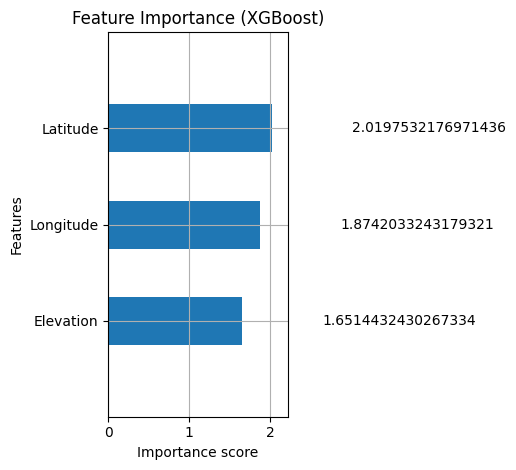

In [46]:
import matplotlib.pyplot as plt

xgb.plot_importance(model, importance_type='gain', height=0.5)
plt.title("Feature Importance (XGBoost)")
plt.tight_layout()
plt.show()

# Tensorflow.keras

Epoch 1/100
135/135 - 1s - 10ms/step - accuracy: 0.1981 - loss: 2.1240 - val_accuracy: 0.3423 - val_loss: 2.0316
Epoch 2/100
135/135 - 1s - 4ms/step - accuracy: 0.2134 - loss: 2.0031 - val_accuracy: 0.2920 - val_loss: 1.9974
Epoch 3/100
135/135 - 0s - 4ms/step - accuracy: 0.2097 - loss: 1.9805 - val_accuracy: 0.2509 - val_loss: 1.9765
Epoch 4/100
135/135 - 0s - 4ms/step - accuracy: 0.2143 - loss: 1.9521 - val_accuracy: 0.2311 - val_loss: 1.9765
Epoch 5/100
135/135 - 0s - 4ms/step - accuracy: 0.2127 - loss: 1.9324 - val_accuracy: 0.2296 - val_loss: 1.9550
Epoch 6/100
135/135 - 0s - 4ms/step - accuracy: 0.2053 - loss: 1.8916 - val_accuracy: 0.2136 - val_loss: 1.9459
Epoch 7/100
135/135 - 0s - 3ms/step - accuracy: 0.2044 - loss: 1.9085 - val_accuracy: 0.2385 - val_loss: 1.8891
Epoch 8/100
135/135 - 0s - 4ms/step - accuracy: 0.2113 - loss: 1.8835 - val_accuracy: 0.2344 - val_loss: 1.8827
Epoch 9/100
135/135 - 1s - 4ms/step - accuracy: 0.2227 - loss: 1.8700 - val_accuracy: 0.2319 - val_loss

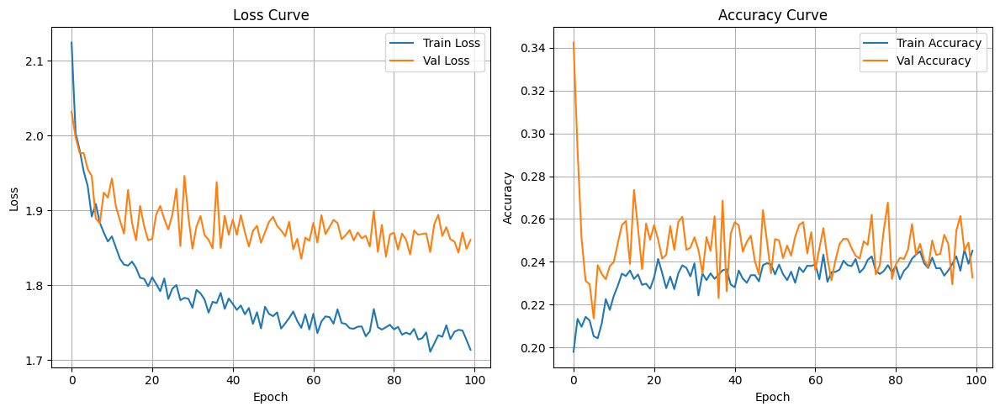

In [66]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.utils.class_weight import compute_class_weight
from sklearn.metrics import classification_report
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, BatchNormalization, Input
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.callbacks import EarlyStopping
import matplotlib.pyplot as plt

# Load and prepare data
df = pd.read_csv("resources/boreholes_reshaped_layers_lithology_group.csv")
df = df.drop_duplicates(subset=["Borehole ID"])
features = ['Latitude', 'Longitude', 'Elevation']
target = 'Lithology_Rank_1'

# Drop rows with missing values
df = df.dropna(subset=features + [target])

# Convert tuple labels to plain strings
df[target] = df[target].astype(str)

# Encode labels
le = LabelEncoder()
df['Lith_1_encoded'] = le.fit_transform(df[target])
num_classes = len(le.classes_)

# Normalize features
scaler = StandardScaler()
X = scaler.fit_transform(df[features])
y = df["Lith_1_encoded"].values
y_cat = to_categorical(y, num_classes=num_classes)

# Train/test split
X_train, X_test, y_train, y_test = train_test_split(X, y_cat, test_size=0.2, random_state=42)

# Compute class weights
y_train_labels = np.argmax(y_train, axis=1)
class_weights = compute_class_weight(class_weight='balanced', classes=np.unique(y_train_labels), y=y_train_labels)
class_weights_dict = dict(enumerate(class_weights))

# Build model
model = Sequential([
    Input(shape=(X_train.shape[1],)),

    Dense(256, activation='relu'),
    BatchNormalization(),
    Dropout(0.3),

    Dense(128, activation='relu'),
    BatchNormalization(),
    Dropout(0.3),

    Dense(128, activation='relu'),
    Dropout(0.2),

    Dense(64, activation='relu'),
    Dropout(0.2),

    Dense(32, activation='relu'),
    Dropout(0.1),

    Dense(num_classes, activation='softmax')
])

# Compile
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Early stopping
early_stop = EarlyStopping(patience=15, restore_best_weights=True)

# Train
history = model.fit(
    X_train, y_train,
    validation_data=(X_test, y_test),
    epochs=100,
    batch_size=512,
    class_weight=class_weights_dict,
    # callbacks=[early_stop],
    verbose=2
)

# Predict
y_pred_probs = model.predict(X_test)
y_pred = np.argmax(y_pred_probs, axis=1)
y_true = np.argmax(y_test, axis=1)

# Classification report fix: use all classes
all_labels = np.arange(num_classes)

print("\nClassification Report (Neural Net):\n")
print(classification_report(
    y_true,
    y_pred,
    labels=all_labels,
    target_names=[str(label) for label in le.inverse_transform(all_labels)],
    zero_division=0
))

# Plot loss curve
fig, axs = plt.subplots(1, 2, figsize=(12, 5))

# Loss plot
axs[0].plot(history.history['loss'], label='Train Loss')
axs[0].plot(history.history['val_loss'], label='Val Loss')
axs[0].set_title('Loss Curve')
axs[0].set_xlabel('Epoch')
axs[0].set_ylabel('Loss')
axs[0].legend()
axs[0].grid(True)

# Accuracy plot
axs[1].plot(history.history['accuracy'], label='Train Accuracy')
axs[1].plot(history.history['val_accuracy'], label='Val Accuracy')
axs[1].set_title('Accuracy Curve')
axs[1].set_xlabel('Epoch')
axs[1].set_ylabel('Accuracy')
axs[1].legend()
axs[1].grid(True)

plt.tight_layout()
plt.show()


# K-Means Clustering

Adjusted Rand Index (ARI): 0.0067
Accuracy (cluster remapped): 0.4249


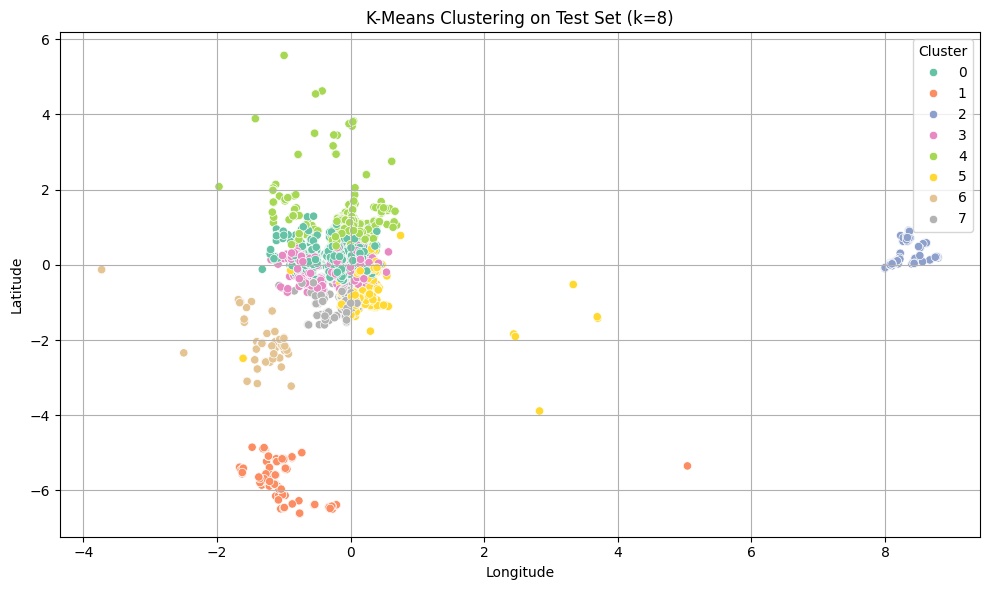

In [65]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import adjusted_rand_score, accuracy_score
from sklearn.model_selection import train_test_split
from scipy.stats import mode
import numpy as np

# Load data
df = pd.read_csv("resources/boreholes_reshaped_layers_lithology_group.csv")

# Drop duplicates and NaNs
df = df.drop_duplicates(subset=["Borehole ID"])
features = ['Latitude', 'Longitude', 'Elevation']
target = 'Lithology_Rank_1'
df = df.dropna(subset=features + [target])

# Standardize features
scaler = StandardScaler()
X = scaler.fit_transform(df[features])
y = df[target].astype(int).values  # Ensure it's numeric

# Train-test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

def get_cluster_label_map(y_true_train, y_cluster_train):
    label_map = {}
    for cluster in np.unique(y_cluster_train):
        mask = (y_cluster_train == cluster)
        majority_label = mode(y_true_train[mask], keepdims=True).mode[0]
        label_map[cluster] = majority_label
    return label_map

def apply_cluster_label_map(y_cluster, label_map):
    return np.array([label_map.get(cluster, -1) for cluster in y_cluster])  # -1 as fallback


# Fit KMeans on training data
k = len(np.unique(y))  # Use number of unique lithology ranks

# Fit KMeans on training data
kmeans = KMeans(n_clusters=k, random_state=42, n_init='auto')
y_train_cluster = kmeans.fit_predict(X_train)
y_test_cluster = kmeans.predict(X_test)

# Remap test clusters to predicted labels
label_map = get_cluster_label_map(y_train, y_train_cluster)
y_test_pred = apply_cluster_label_map(y_test_cluster, label_map)



# Adjust cluster labels to match ground truth using majority vote
def remap_clusters(y_true, y_cluster):
    label_map = {}
    for cluster in np.unique(y_cluster):
        mask = (y_cluster == cluster)
        most_common = mode(y_true[mask], keepdims=True).mode[0]
        label_map[cluster] = most_common
    return np.array([label_map[cluster] for cluster in y_cluster])

# Accuracy and ARI evaluation
accuracy = accuracy_score(y_test, y_test_pred)
ari = adjusted_rand_score(y_test, y_test_cluster)

# Print metrics
print(f"Adjusted Rand Index (ARI): {ari:.4f}")
print(f"Accuracy (cluster remapped): {accuracy:.4f}")

# Optional: Plot clusters from test set
df_test = pd.DataFrame(X_test, columns=features)
df_test['True'] = y_test
df_test['Cluster'] = y_test_cluster

plt.figure(figsize=(10, 6))
sns.scatterplot(data=df_test, x='Longitude', y='Latitude', hue='Cluster', palette='Set2')
plt.title(f"K-Means Clustering on Test Set (k={k})")
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.legend(title="Cluster")
plt.tight_layout()
plt.grid(True)
plt.show()
